In [1]:
suppressPackageStartupMessages({
    library(SingleCellExperiment)
    library(scran)
    library(dplyr)
    library(ggplot2)
    library(scater)
    library(gridExtra)
    library(ggthemes)
    library(ggsankey)
    library(APL)
    library(plotly)
    library(CAbiNet)
    
    })

## Load the pre-processed data

In [2]:
## Please first load the preprocessed dataset 'PBMC_10X_filtered.rds' from the online repository to folder Preprocessing//ExperimentalData/preprocessed/ 
## or load to anywhere you want in your local directory and load it as sce
### change the path to you local directory
sce = readRDS('../Data/real_data/preprocessed/dmel_E14-16h_filtered.rds')

sce

class: SingleCellExperiment 
dim: 7178 14808 
metadata(2): study scDblFinder.stats
assays(2): counts logcounts
rownames(7178): 128up 14-3-3epsilon ... zyd zye
rowData names(2): SYMBOL scDblFinder.selected
colnames(14808): E14-16h_a_S01_20500x62780-0
  E14-16h_a_S01_20500x62800-0 ... E14-16h_a_S16_61760x79380-15
  E14-16h_a_S16_61760x79400-15
colData names(24): slice_ID raw_x ... scDblFinder.mostLikelyOrigin
  scDblFinder.originAmbiguous
reducedDimNames(2): PCA UMAP
mainExpName: NULL
altExpNames(0):

In [3]:
algorithm = 'leiden'
prune = 1/15
resol = 1.2
usegap = NULL
SNN_mode = 'all'
ntop = 2000
truth = 'truth'
dims = 150
NNs = c(60, 10, 10, 10)
graph_select <- TRUE
gcKNN <- TRUE
overlap <- 0.1
nclust = NULL

data = sce

  if (!is.na(ntop)){

        genevars <- modelGeneVar(data, assay.type = "logcounts")

#         if (isTRUE(graph_select)){

#             chosen <- getTopHVGs(genevars, prop = 0.8, var.threshold = NULL)

#         } else {
            

            chosen <- getTopHVGs(genevars, n = ntop, var.threshold = NULL)

        # }

        data_old <- data
        data <- data[rownames(data) %in% chosen,]
    }
    
    # rename rows of data as gene AYMBOL
    rowData(data)$ENSMBL = rownames(data)
    rowData(data)$GeneName = rowData(data)$SYMBOL
    idx = which(is.na(rowData(data)$GeneName ))
    rowData(data)$GeneName[idx] = rownames(rowData(data))[idx]
    rownames(data) = rowData(data)$GeneName

    
    cnts <- as.matrix(logcounts(data))


    trueclusters = colData(data)[,colnames(colData(data)) == truth]


In [4]:
dim(cnts)

[1]  2000 14808

## Correspondence Analysis

In [5]:
#use logcounts as input of cacomp

caobj = cacomp(cnts,
               dims = dims,
               ntop = nrow(cnts),
               python = TRUE, 
              clip = TRUE)

prinInertia <- caobj@D^2
    percentInertia <- prinInertia / sum(prinInertia) * 100

    # Saving the results
    ca <- caobj@std_coords_cols
    attr(ca, "prin_coords_rows") <- caobj@prin_coords_rows
    attr(ca, "singval") <- caobj@D
    attr(ca, "percInertia") <- percentInertia
    attr(ca, "params") <- caobj@params
    
    SingleCellExperiment::reducedDim(data, "CA") <- ca

Warning message in run_cacomp(obj = obj, coords = coords, princ_coords = princ_coords, :
“
Parameter top is >nrow(obj) and therefore ignored.”


## Run the CAbiNet biclustering algorithm with function 'caclust'

In [6]:

data <- caclust(obj = data,
              k = NNs,
              loops = FALSE,
              SNN_prune = prune,
              mode = SNN_mode,
              select_genes = graph_select,
              resolution = resol,
              prune_overlap = TRUE,
              overlap = overlap,
              calc_gene_cell_kNN = gcKNN,
              algorithm = 'leiden',
              leiden_pack = 'leiden',
              rand_seed = 2358)

Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.7 GiB”


In [7]:
ARI = mclust::adjustedRandIndex(data$caclust, data$truth)
ARI

[1] 0.3181903

## Old fashioned joint visualization of cells and genes by CA biplot 

Warning message in ggplot2::geom_point(data = rows, ggplot2::aes_(x = as.name(rnmx), :
“Ignoring unknown aesthetics: text”
Warning message in ggplot2::geom_point(data = cols, ggplot2::aes_(x = as.name(cnmx), :
“Ignoring unknown aesthetics: text”


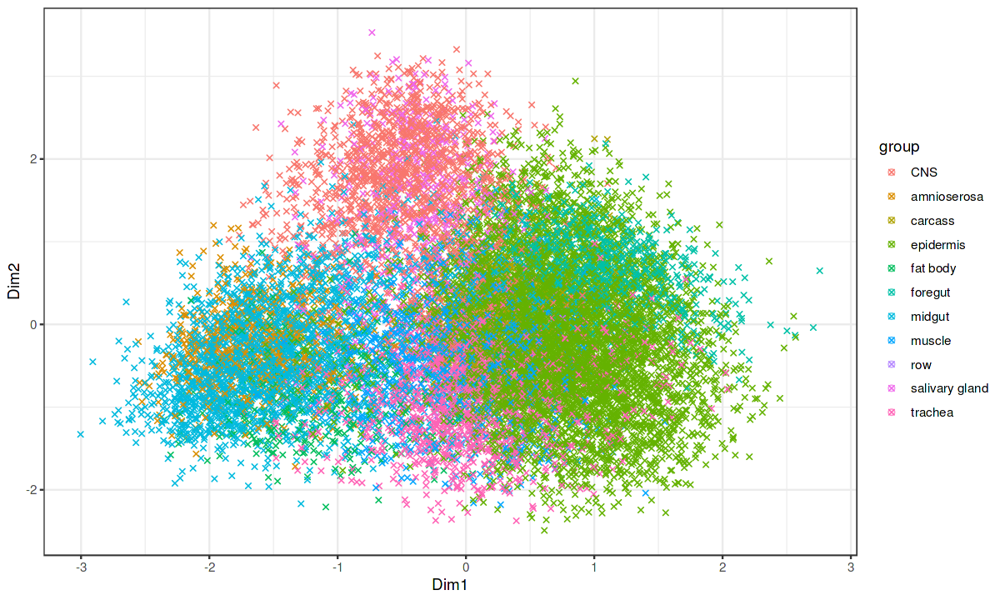

In [8]:
options(repr.plot.width=10, repr.plot.height=6)

clist = data$truth
names(clist) = colnames(data)

ca_biplot(caobj, col_metadata = clist)

In [9]:
source('helpers.R')

subdata = rm_raremonoclusters_sce(data)

metadata(subdata)$caclust

caclust object with 14808 cells and 248 genes.
13 clusters found.
Clustering results:

 cluster ncells ngenes
 1       3413    6    
 2       1691   12    
 3       1371   16    
 4       1329   25    
 5       1293   15    
 6       1270   20    
 7       1006   13    
 8        873   12    
 9        821   11    
 10       527   14    
 11       492   12    
 12       323    8    
 13       212   17    

Module(umap)

Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.6 GiB”
Warning message:
“ggrepel: 127 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


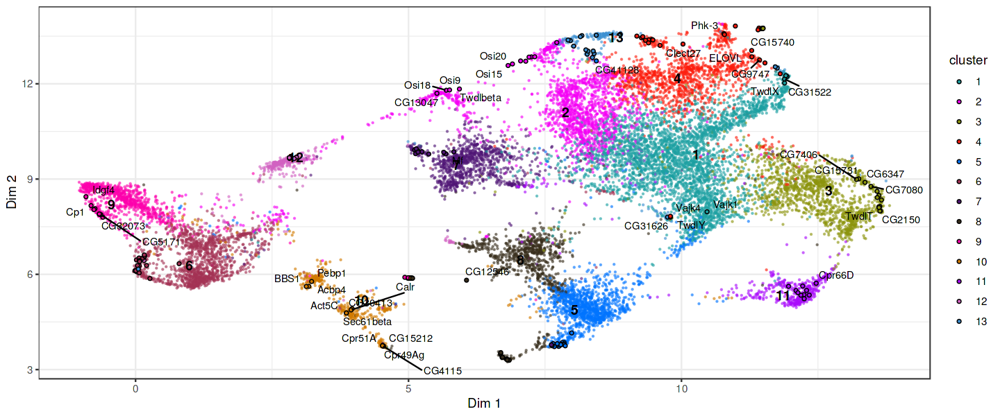

In [10]:
reticulate::import('umap')
options(repr.plot.width=12, repr.plot.height=5)

subdata = CAbiNet::biMAP(subdata, k = 10, method = 'SNNdist', rand_seed = 2358)

p2 = plot_biMAP(subdata,  color_by = 'cluster', color_genes = TRUE,
                label_marker_genes = TRUE,
                cell_size = 0.2, gene_size = 1, cell_alpha = 0.5, gene_alpha = 1 ) 
p2

## New annotation of the biclusters

In [11]:
subdata$CAbiNet = as.numeric(subdata$caclust)
subdata$CAbiNet[subdata$CAbiNet == 1] = 'epidermis'
subdata$CAbiNet[subdata$CAbiNet == 3] = 'head epidermis'
subdata$CAbiNet[subdata$CAbiNet == 13] = 'ventral epidermis'

subdata$CAbiNet[subdata$CAbiNet == 2] = 'trachea'
subdata$CAbiNet[subdata$CAbiNet == 6] = 'midgut'
subdata$CAbiNet[subdata$CAbiNet == 9] = 'yolk'
subdata$CAbiNet[subdata$CAbiNet == 10] = 'gastric caecum'

subdata$CAbiNet[subdata$CAbiNet == 5] = 'CNS'
subdata$CAbiNet[subdata$CAbiNet == 8] = 'salivary gland'
subdata$CAbiNet[subdata$CAbiNet == 7] = 'somatic muscle'
# subdata$CAbiNet[subdata$CAbiNet %in% c( 10, 15)] = 'amnoioserosa'
subdata$CAbiNet[subdata$CAbiNet == 11] = 'foregut'
subdata$CAbiNet[subdata$CAbiNet == 4] = 'dorsal epidermis'

subdata$CAbiNet[subdata$CAbiNet == 12] = 'fat body'
mclust::adjustedRandIndex(subdata$CAbiNet, subdata$truth)

[1] 0.3275282

## Figure 4d: Sankey Plot shows the overlapping between the cell-type annotations from original publication, the biclustering results and the new cell-type annotations

Warning message:
“attributes are not identical across measure variables;
they will be dropped”
`summarise()` has grouped output by 'Biclusters', 'Truth'. You can override
using the `.groups` argument.


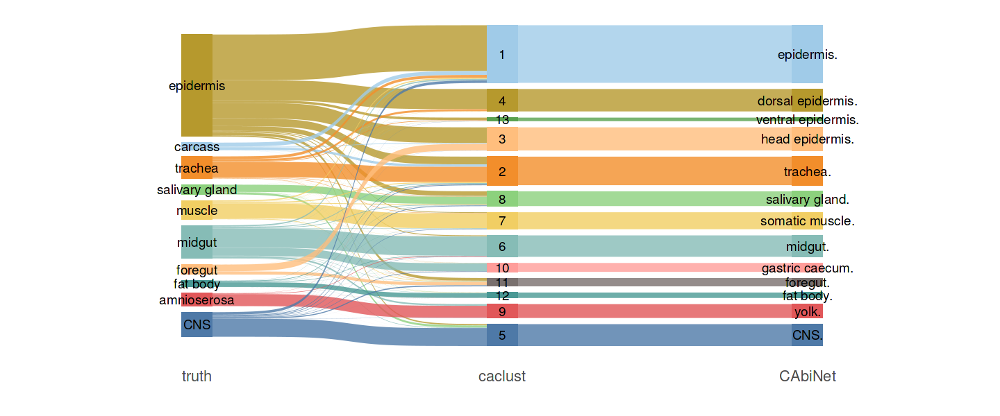

In [12]:
coldf = colData(subdata)
coldf$CAbiNet = paste0(coldf$CAbiNet, '.')
# coldf$caclust = paste0('CAbiNet ', coldf$caclust)

df <- coldf %>% as_tibble() %>% dplyr::select(truth, caclust, CAbiNet) %>%
    # make_long(bicluster, annotation)
    make_long(truth, caclust, CAbiNet)

info  <-  data.frame(Biclusters = as.factor(coldf$caclust),
                  Truth = as.character(coldf$truth),
                    Annotation = as.character(coldf$CAbiNet)) %>%  
                as_tibble() %>%
                group_by(Biclusters, Truth, Annotation) %>% 
                summarise(n = n()) %>%
                group_by(Truth) %>%
                mutate(Partition = n/sum(n)) %>%
                dplyr::select(-c(n)) %>%
                ungroup() %>% 
                as.data.frame() %>% 
                group_by(Biclusters, Annotation) %>%
                filter(Partition == max(Partition) ) %>%
                dplyr::select(Biclusters, Truth, Annotation) %>%
                distinct(Biclusters, .keep_all = TRUE)


cts <- unique(coldf$CAbiNet)
pal <- tableau_color_pal('Tableau 20')
cols <- pal(length(cts))
info <- left_join(data.frame("Annotation" = cts, "col" = cols), info, by = "Annotation")
cols <- c(cols, info$col, info$col)
names(cols) <- c(as.character(cts), as.character(info$Biclusters), as.character(info$Truth))



order = c('epidermis', 'carcass',
         'trachea', 'salivary gland',
         'muscle', 'midgut',
         'foregut', 'fat body',
         'amnioserosa', 'CNS',
           '1', 
         '4',
         '13',
         '3', 
         '2', 
         '8', 
         '7', 
         '6', 
         '10', 
         '11', 
         '12', 
         '9', 
         '5', 
          'epidermis.',
          'dorsal epidermis.',
          'ventral epidermis.',
          'head epidermis.',
         'trachea.', 'salivary gland.',
         'somatic muscle.', 'midgut.',
          'gastric caecum.',
         'foregut.', 'fat body.',
         'yolk.', 'CNS.'
         )

order = order[seq(to = 1, by = -1, length.out = length(order))]

wrap <- length(order)
df$node <- factor(stringr::str_wrap(df$node, wrap), levels = stringr::str_wrap(order, wrap))
df$next_node <- factor(stringr::str_wrap(df$next_node, wrap), levels = stringr::str_wrap(order, wrap))

names(cols) <- stringr::str_wrap(names(cols), wrap)

sank <- ggplot(df, aes(x = x, 
               next_x = next_x, 
               node = node, 
               next_node = next_node,
               fill = node,
               label = as.character(node))) +
  geom_sankey(flow.alpha = 0.8) +
  # geom_sankey_label(size = 2, color = "black",  hjust = -1)+ #fill= "white",
  geom_sankey_text() +
# geom_sankey_text(size = 3, color = "black", fill = NA, hjust = 0, position = position_nudge(x = 0.1))+
  labs(x = "") +
  scale_fill_manual(values = cols) +
  theme_sankey(base_size = 16) +
  theme(legend.position = "none") 
sank
# ggsave('Fig5d_sankeyplot.pdf', width = 6, height = 5)

## Figure 4a: UMAP visualization of cells - the old way of visualizing scRNA-seq data
### UMAP with expert annotated cell types (left) and biclustering results (right)

In [13]:
truth_cols = cols[names(cols) %in% unique(subdata$truth)]
ca_cols = cols[names(cols) %in% unique(coldf$caclust)]

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


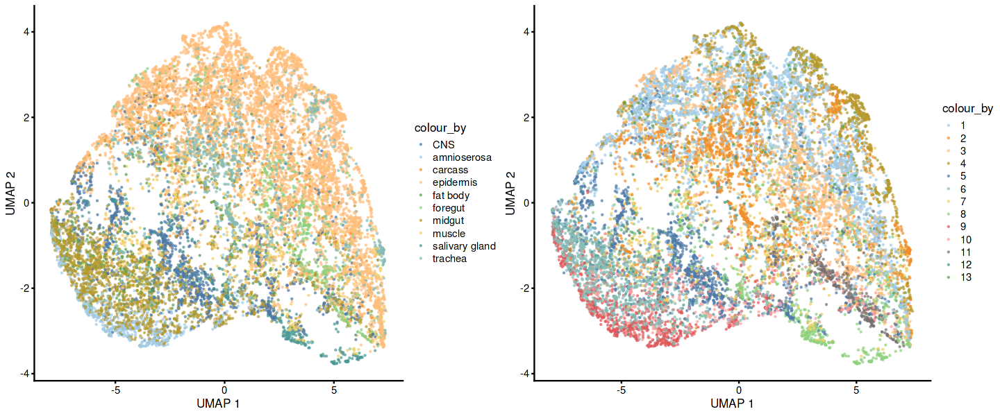

In [14]:
options(repr.plot.width=12, repr.plot.height=5)
library(gridExtra)
# p1 = plotPCA(data, colour_by = 'truth')
p1 = plotUMAP(subdata, colour_by = 'truth',  point_size = 0.2) + scale_color_tableau(
  palette = "Tableau 20",
  type = "regular",
  direction = 1
)

p2 = plotUMAP(subdata, colour_by = 'caclust', point_size = 0.2) +  scale_color_manual(values = ca_cols) + 
        scale_fill_manual(values = ca_cols)

p = grid.arrange(p1, p2, nrow = 1)

## Figure 4b: biMAP - a joint visualization of cells and corresponding 'marker' genes
### The biMAPs with expert annotated cell types (on the left) and the biclustering results (on the right)

Module(umap)

Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.6 GiB”
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
“ggrepel: 148 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 148 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


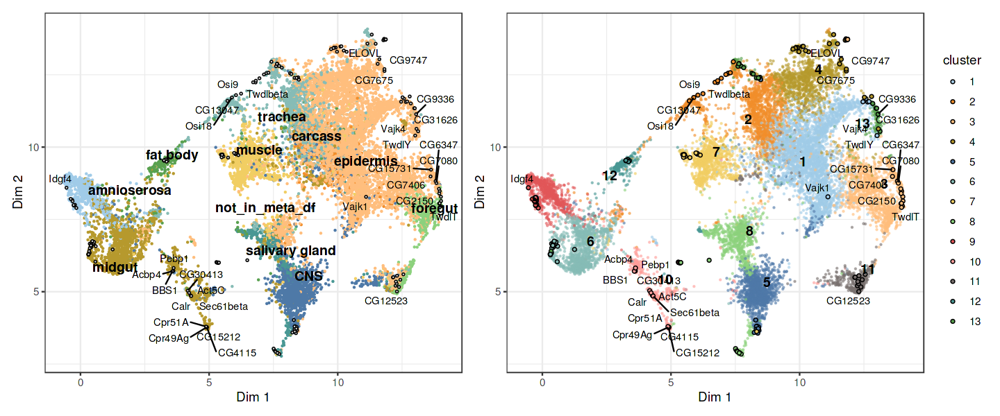

In [15]:
reticulate::import('umap')
options(repr.plot.width=12, repr.plot.height=5)

set.seed(42)

subdata = CAbiNet::biMAP(subdata, k = 10, method = 'SNNdist', rand_seed = 66)

p1 = plot_biMAP(subdata,  color_by = 'truth', color_genes = TRUE, label_groups = TRUE,
                 label_marker_genes = TRUE,
                cell_size = 0.2, gene_size = 0.5, cell_alpha = 1, gene_alpha = 1 ) + 
        theme(legend.position = 'none') + 
        scale_color_tableau(
                                      palette = "Tableau 20",
                                      type = "regular",
                                      direction = 1)
p2 = plot_biMAP(subdata,  color_by = 'cluster', color_genes = TRUE,
                 label_marker_genes = TRUE,
               cell_size = 0.2, gene_size = 1, cell_alpha = 0.5, gene_alpha = 1 ) +
   scale_color_manual(values = ca_cols) + 
        scale_fill_manual(values = ca_cols)

p1 + p2

In [16]:
# ggsave("Fig5b_dmel_bimap_bicluster.png", p2, width = 5, height = 4)
# ggsave("Fig5b_dmel_bimap_bicluster.pdf", p2, width = 5, height = 4)

In [17]:
# ggsave("Fig_dmel_bimap_bicluster.pdf", p1+p2, width = 18, height = 6)

In [18]:
fig = plotly::ggplotly(p2)
fig

Warning message in geom2trace.default(dots[[1L]][[1L]], dots[[2L]][[1L]], dots[[3L]][[1L]]):
“geom_GeomTextRepel() has yet to be implemented in plotly.
  If you'd like to see this geom implemented,
  Please open an issue with your example code at
  https://github.com/ropensci/plotly/issues”
Warning message in geom2trace.default(dots[[1L]][[1L]], dots[[2L]][[1L]], dots[[3L]][[1L]]):
“geom_GeomTextRepel() has yet to be implemented in plotly.
  If you'd like to see this geom implemented,
  Please open an issue with your example code at
  https://github.com/ropensci/plotly/issues”


HTML widgets cannot be represented in plain text (need html)

In [19]:
htmlwidgets::saveWidget(as_widget(fig), "SupplM3_Fig4b_dmel_biclusters_plotly.html")


## Figure 4e: Spatial 3D visualization of cells with new cell type annotations

In [20]:

anno_cols = cols[which(names(cols) %in% paste0(unique(subdata$CAbiNet), '.'))]
anno = subdata$CAbiNet
anno = paste0(anno, '.')
                  
p =plot_ly(x = subdata$new_x, 
           y= subdata$new_y, 
           frame = F, 
           z=subdata$new_z,  
           color = anno,
           colors = anno_cols,
           type="scatter3d", 
           mode = 'markers' , 
           alpha = 1, 
           size = 2) %>% layout(scene = list(camera = list(eye = list(x =1.2,y = -1.2, z= -1.2),
                                              center = list(x = 0,
                                                            y = 0,
                                                            z = 0
                                                            ))))
htmlwidgets::saveWidget(as_widget(p), "SupplM4_Fig4e_3dscatter_annotation.html")
# plotly::save_image(p, '3dscatter_annotation.pdf')
p

HTML widgets cannot be represented in plain text (need html)

In [21]:
samples = c('head epidermis.' ,'foregut.', 'gastric caecum.', 'midgut.')
p =plot_ly(x = subdata[,anno %in% samples]$new_x, 
           y= subdata[,anno %in% samples]$new_y, 
           frame = F, 
           z=subdata[,anno %in% samples]$new_z,  
           color = anno[which(anno %in% samples)],
           colors = anno_cols[names(anno_cols) %in% samples],
           type="scatter3d", 
           mode = 'markers' , 
           alpha = 1, 
           size = 1) %>% layout(scene = list(camera = list(eye = list(x =1.2,y = -1.2, z= -1.2),
                                              center = list(x = 0,
                                                            y = 0,
                                                            z = 0
                                                            ))))
p
htmlwidgets::saveWidget(as_widget(p),  "SupplM5_Fig4e_3dscatter_annotation_sub_.html")

# plotly::save_image(p, file = "3dscatter_annotation_sub.pdf")

HTML widgets cannot be represented in plain text (need html)

## Figure 4c: feture plots/biMAPs of marker genes

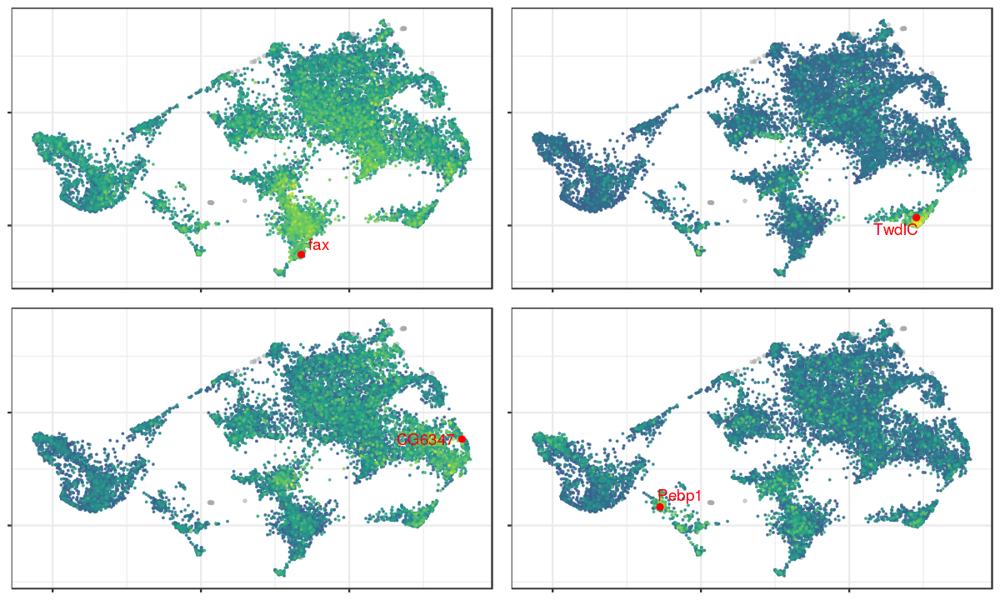

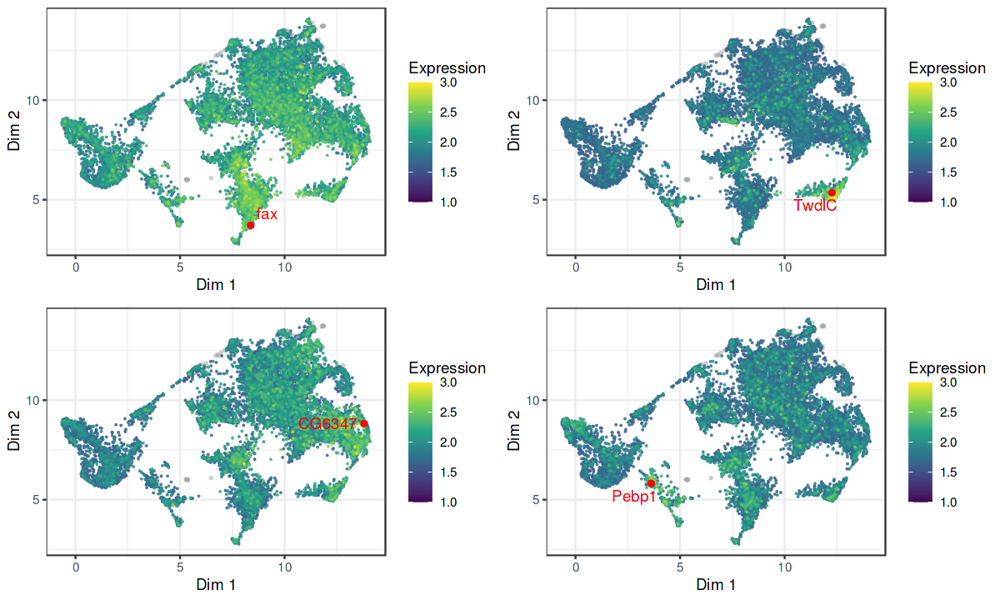

In [22]:
options(repr.plot.width=10, repr.plot.height=6)

p = features_biMAP(subdata, metadata(subdata)$caclust, 
               features = c('fax', 'TwdlC',  'CG6347', 'Pebp1'), 
                   cell_size = 0.05, gene_size = 0.5,
                  show_legend = FALSE,
                   show_labs = FALSE,
                   max_cutoff = 3,
                   min_cutoff = 1,
                  ncol = 2,
                   width = 4,
                   height = 4,
                  filename = 'Fig5c_dmel_markergenes_withoutlegends')+ 
            theme(legend.position = c(0.8, 0.2), 
                  legend.key.size = unit(0.2, 'cm'))

p = features_biMAP(subdata, metadata(subdata)$caclust, 
               features = c('fax', 'TwdlC',  'CG6347', 'Pebp1'), 
                   cell_size = 0.05, gene_size = 0.5,
                  show_legend = TRUE,
                   min_cutoff = 1,
                   max_cutoff = 3,
                  ncol = 2,
                   width = 6,
                   height = 4,
                  filename = 'Fig5c_dmel_markergenes_withlegends')+ 
            theme(legend.position = c(0.8, 0.2), 
                  legend.key.size = unit(0.2, 'cm'))


In [23]:
mklist = read.csv('/home/zhao/02.Projects/Projects/ClusteringMtd/01.Datasets/spatialtsc/Annotation Rmd/full_stage_anno.csv')
## if you want to get this file, please contact yanzhao1006@gmail.com
head(mklist)

# unique(mklist$Developmental.stage.name)
mklist = mklist[mklist$Developmental.stage.name == 'embryonic stage 16',]
mklist = mklist[mklist$Gene.name %in% rownames(subdata),]
dim(mklist)

mklist %>% filter(Anatomical.entity.name != 'embryo') %>% 
group_by(Gene.name) %>% 
mutate (n.tussue = n()) -> mklist#%>% 

genedf = as.data.frame(gene_clusters(metadata(subdata)$caclust))
colnames(genedf) = 'caclust'
genedf$Gene.name = rownames(genedf)
genedf = merge(mklist, genedf, by = 'Gene.name')
# genedf[1:20,]
genedf %>% 
        group_by(caclust, Anatomical.entity.name) %>% 
        mutate(freq = n()) %>% 
        ungroup() %>% 
        group_by(caclust) %>% 
        filter(freq == max(freq),Expression.score == max(Expression.score) ) %>%
        arrange(caclust)-> gene.anno
# head(gene.anno)

,Gene.ID,Gene.name,Developmental.stage.name,Anatomical.entity.name,Expression.score,Source,stage_part_of_1,stage_part_of_2,stage_part_of_3,anatomy_part_of_1,anatomy_part_of_2,anatomy_part_of_3
,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
1,FBgn0000003,7SLRNA:CR32864,day 4 of adulthood,testis,86.28,Bgee,adult stage,NA,NA,larva,NA,NA
2,FBgn0000003,7SLRNA:CR32864,day 4 of adulthood,testis,93.63,Bgee,adult stage,NA,NA,larva,NA,NA
3,FBgn0000003,7SLRNA:CR32864,adult stage,testis,88.06,Bgee,NA,NA,NA,larva,NA,NA
4,FBgn0000003,7SLRNA:CR32864,late extended germ band stage,embryo,99.98,Bgee,extended germ band stage,embryonic stage,NA,NA,NA,NA
5,FBgn0000003,7SLRNA:CR32864,pre-blastoderm stage,embryo,95.34,Bgee,cleavage stage,embryonic stage,NA,NA,NA,NA
6,FBgn0000003,7SLRNA:CR32864,embryonic stage 4,embryo,99.97,Bgee,blastoderm stage,embryonic stage,NA,NA,NA,NA


[1] 10236    12

In [24]:
# gene.anno %>% 
#             select(Anatomical.entity.name, caclust) %>% 
#             filter(!duplicated(Anatomical.entity.name))

In [25]:
head(mklist)
grep('fax', mklist$Gene.name)

Gene.ID,Gene.name,Developmental.stage.name,Anatomical.entity.name,Expression.score,Source,stage_part_of_1,stage_part_of_2,stage_part_of_3,anatomy_part_of_1,anatomy_part_of_2,anatomy_part_of_3,n.tussue
<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>
FBgn0000014,abd-A,embryonic stage 16,dorsal epidermis,50.00,Bgee,late embryonic stage,embryonic stage,NA,epidermis,integumentary system,adult,3
FBgn0000014,abd-A,embryonic stage 16,ventral epidermis,50.00,Bgee,late embryonic stage,embryonic stage,NA,epidermis,integumentary system,adult,3
FBgn0000014,abd-A,embryonic stage 16,ventral nerve cord,49.97,Bgee,late embryonic stage,embryonic stage,NA,central nervous system,nervous system,adult,3
FBgn0000042,Act5C,embryonic stage 16,muscle system,49.98,Bgee,late embryonic stage,embryonic stage,NA,adult,NA,NA,10
FBgn0000042,Act5C,embryonic stage 16,midgut,49.99,Bgee,late embryonic stage,embryonic stage,NA,gut,alimentary canal,pupal/digestive system,10
FBgn0000042,Act5C,embryonic stage 16,ventral sensory complex primordium,50.00,Bgee,late embryonic stage,embryonic stage,NA,ventral trunk epidermis primordium,dorsal closure embryo,NA,10


integer(0)

In [26]:
caclust_genedf = data.frame(caclust = gene_clusters(metadata(subdata)$caclust))
caclust_genedf$caclust = as.numeric(caclust_genedf$caclust)
cns.mk = rownames(caclust_genedf)[caclust_genedf$caclust == 5]
gene.anno[gene.anno$Gene.name %in% cns.mk,]

Gene.name,Gene.ID,Developmental.stage.name,Anatomical.entity.name,Expression.score,Source,stage_part_of_1,stage_part_of_2,stage_part_of_3,anatomy_part_of_1,anatomy_part_of_2,anatomy_part_of_3,n.tussue,caclust,freq
<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<fct>,<int>
Bacc,FBgn0031453,embryonic stage 16,multicellular organism,97.7,Bgee,late embryonic stage,embryonic stage,NA,NA,NA,NA,6,5,8


In [27]:
cns.mk
length(cns.mk)

[1] "14-3-3epsilon" "Bacc"          "CG2852"        "CG41128"      
 [5] "Cam"           "Gbeta13F"      "His4r"         "HmgZ"         
 [9] "arm"           "chic"          "fabp"          "fax"          
[13] "mts"           "ps"            "smt3"

[1] 15

In [28]:
inlist = mklist[mklist$Gene.name %in% cns.mk,]
inlist[!duplicated(inlist$Gene.name),]

Gene.ID,Gene.name,Developmental.stage.name,Anatomical.entity.name,Expression.score,Source,stage_part_of_1,stage_part_of_2,stage_part_of_3,anatomy_part_of_1,anatomy_part_of_2,anatomy_part_of_3,n.tussue
<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>
FBgn0000117,arm,embryonic stage 16,multicellular organism,96.33,Bgee,late embryonic stage,embryonic stage,NA,NA,NA,NA,1
FBgn0000253,Cam,embryonic stage 16,germline cell,50.00,Bgee,late embryonic stage,embryonic stage,NA,NA,NA,NA,14
FBgn0001105,Gbeta13F,embryonic stage 16,midgut,49.99,Bgee,late embryonic stage,embryonic stage,NA,gut,alimentary canal,pupal/digestive system,12
FBgn0004177,mts,embryonic stage 16,midgut,49.99,Bgee,late embryonic stage,embryonic stage,NA,gut,alimentary canal,pupal/digestive system,5
FBgn0010228,HmgZ,embryonic stage 16,midgut,49.99,Bgee,late embryonic stage,embryonic stage,NA,gut,alimentary canal,pupal/digestive system,4
FBgn0031453,Bacc,embryonic stage 16,midgut,49.99,Bgee,late embryonic stage,embryonic stage,NA,gut,alimentary canal,pupal/digestive system,6
FBgn0037913,fabp,embryonic stage 16,dorsal lateral subperineurial glia,50.00,Bgee,late embryonic stage,embryonic stage,NA,ventral nerve cord,central nervous system,nervous system,8
FBgn0069923,CG41128,embryonic stage 16,multicellular organism,96.98,Bgee,late embryonic stage,embryonic stage,NA,NA,NA,NA,1
FBgn0261552,ps,embryonic stage 16,muscle system,55.54,Bgee,late embryonic stage,embryonic stage,NA,adult,NA,NA,15


In [29]:
cns.mk = rownames(caclust_genedf)[caclust_genedf$caclust == 11]
inlist = mklist[mklist$Gene.name %in% cns.mk,]
inlist[!duplicated(inlist$Gene.name),]
cns.mk
length(cns.mk)

Gene.ID,Gene.name,Developmental.stage.name,Anatomical.entity.name,Expression.score,Source,stage_part_of_1,stage_part_of_2,stage_part_of_3,anatomy_part_of_1,anatomy_part_of_2,anatomy_part_of_3,n.tussue
<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>
FBgn0033869,Cpr50Cb,embryonic stage 16,foregut,62.49,Bgee,late embryonic stage,embryonic stage,NA,gut,alimentary canal,pupal/digestive system,3
FBgn0034499,Cpr56F,embryonic stage 16,posterior spiracle,50.00,Bgee,late embryonic stage,embryonic stage,NA,stigmatophore,abdominal segment,telson,5
FBgn0036600,CG13043,embryonic stage 16,antennal sense organ,50.00,Bgee,late embryonic stage,embryonic stage,NA,antenna,external head,integumentary system,8
FBgn0039469,TwdlC,embryonic stage 16,foregut,62.49,Bgee,late embryonic stage,embryonic stage,NA,gut,alimentary canal,pupal/digestive system,3
FBgn0052029,Cpr66D,embryonic stage 16,dorsal trunk,50.00,Bgee,late embryonic stage,embryonic stage,NA,dorsum,NA,NA,4
FBgn0052405,Cpr65Av,embryonic stage 16,posterior spiracle,50.00,Bgee,late embryonic stage,embryonic stage,NA,stigmatophore,abdominal segment,telson,7
FBgn0033158,CG12164,embryonic stage 16,proventriculus,100.00,BDGP,late embryonic stage,embryonic stage,NA,gut,alimentary canal,pupal/digestive system,6


[1] "CG12164"       "CG12523"       "CG13043"       "CG13059"      
 [5] "CG7548"        "Ccp84Ac"       "Cpr50Cb"       "Cpr56F"       
 [9] "Cpr65Av"       "Cpr66D"        "TwdlC"         "asRNA:CR45663"

[1] 12

In [30]:
cns.mk = rownames(caclust_genedf)[caclust_genedf$caclust == 3]
inlist = mklist[mklist$Gene.name %in% cns.mk,]
inlist[!duplicated(inlist$Gene.name),]
cns.mk
length(cns.mk)

Gene.ID,Gene.name,Developmental.stage.name,Anatomical.entity.name,Expression.score,Source,stage_part_of_1,stage_part_of_2,stage_part_of_3,anatomy_part_of_1,anatomy_part_of_2,anatomy_part_of_3,n.tussue
<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>
FBgn0003065,CG2150,embryonic stage 16,posterior spiracle,50.00,Bgee,late embryonic stage,embryonic stage,NA,stigmatophore,abdominal segment,telson,18
FBgn0015766,Msr-110,embryonic stage 16,prothoracic gland,50.00,Bgee,late embryonic stage,embryonic stage,NA,ring gland,endocrine system,adult,8
FBgn0027527,Osi6,embryonic stage 16,foregut,56.23,Bgee,late embryonic stage,embryonic stage,NA,gut,alimentary canal,pupal/digestive system,6
FBgn0029170,TwdlT,embryonic stage 16,posterior spiracle,50.00,Bgee,late embryonic stage,embryonic stage,NA,stigmatophore,abdominal segment,telson,6
FBgn0030390,CG15731,embryonic stage 16,head epidermis,49.99,Bgee,late embryonic stage,embryonic stage,NA,epidermis,integumentary system,adult,7
FBgn0030569,CG9411,embryonic stage 16,foregut,62.49,Bgee,late embryonic stage,embryonic stage,NA,gut,alimentary canal,pupal/digestive system,16
FBgn0033874,CG6347,embryonic stage 16,atrium,50.00,Bgee,late embryonic stage,embryonic stage,NA,foregut,gut,alimentary canal,8
FBgn0035685,CG13297,embryonic stage 16,hypopharynx,50.00,Bgee,late embryonic stage,embryonic stage,NA,pharynx,proboscis,mouthpart,10
FBgn0035736,Cpr65Eb,embryonic stage 16,head epidermis,49.99,Bgee,late embryonic stage,embryonic stage,NA,epidermis,integumentary system,adult,3


[1] "CG13297" "CG15731" "CG17127" "CG2150"  "CG6347"  "CG7080"  "CG7406" 
 [8] "CG9411"  "Cpr65Eb" "Jupiter" "Msr-110" "Osi6"    "Osi7"    "TwdlT"  
[15] "TwdlV"   "verm"

[1] 16

In [31]:
cns.mk = rownames(caclust_genedf)[caclust_genedf$caclust == 13]
inlist = mklist[mklist$Gene.name %in% cns.mk,]
inlist[!duplicated(inlist$Gene.name),]
cns.mk
length(cns.mk)

Gene.ID,Gene.name,Developmental.stage.name,Anatomical.entity.name,Expression.score,Source,stage_part_of_1,stage_part_of_2,stage_part_of_3,anatomy_part_of_1,anatomy_part_of_2,anatomy_part_of_3,n.tussue
<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>
FBgn0004629,Cys,embryonic stage 16,midgut,49.99,Bgee,late embryonic stage,embryonic stage,NA,gut,alimentary canal,pupal/digestive system,4
FBgn0020370,TppII,embryonic stage 16,salivary gland,62.50,Bgee,late embryonic stage,embryonic stage,NA,pupal/digestive system,adult,NA,13
FBgn0032511,ND-B22,embryonic stage 16,muscle system,55.54,Bgee,late embryonic stage,embryonic stage,NA,adult,NA,NA,6
FBgn0032897,CG9336,embryonic stage 16,medial ventral subperineurial glia,50.00,Bgee,late embryonic stage,embryonic stage,NA,ventral nerve cord,central nervous system,nervous system,31
FBgn0033570,ND-B14,embryonic stage 16,muscle system,55.54,Bgee,late embryonic stage,embryonic stage,NA,adult,NA,NA,9
FBgn0036289,CG10657,embryonic stage 16,posterior spiracle,50.00,Bgee,late embryonic stage,embryonic stage,NA,stigmatophore,abdominal segment,telson,18
FBgn0037225,TwdlG,embryonic stage 16,head epidermis,49.99,Bgee,late embryonic stage,embryonic stage,NA,epidermis,integumentary system,adult,3
FBgn0039406,RpL34a,embryonic stage 16,multicellular organism,96.56,Bgee,late embryonic stage,embryonic stage,NA,NA,NA,NA,1
FBgn0051626,CG31626,embryonic stage 16,foregut,56.23,Bgee,late embryonic stage,embryonic stage,NA,gut,alimentary canal,pupal/digestive system,10


[1] "CG10657"        "CG31626"        "CG32576"        "CG8860"        
 [5] "CG9336"         "Cys"            "ND-B14"         "ND-B22"        
 [9] "ND-MWFE"        "Obp83g"         "RpL34a"         "TppII"         
[13] "TwdlG"          "Vha16-1"        "asRNA:CR44095"  "asRNA:CR45264" 
[17] "lncRNA:CR42862"

[1] 17

## Figure 4a

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


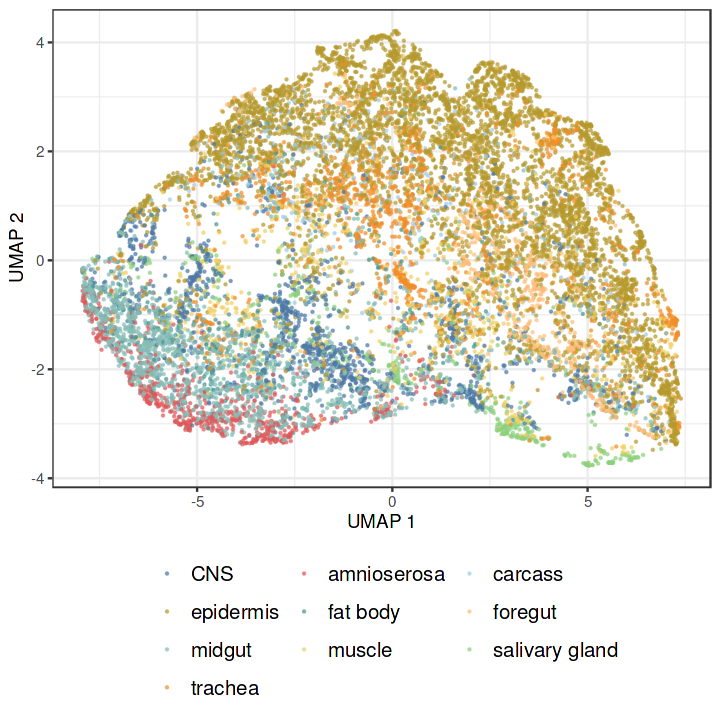

In [32]:
options(repr.plot.width=6, repr.plot.height=6)

truth_cols = cols[names(cols) %in% unique(subdata$truth)]
p1 = plotUMAP(subdata, colour_by = 'truth',  point_size = 0.2)+ theme_bw() + 
                scale_color_manual(values = truth_cols) + 
                theme(legend.position = 'bottom', 
                                                legend.box="vertical",
                                                legend.text = element_text(size = 12)) +
                guides(color=guide_legend(title = NULL,nrow=4, byrow=TRUE))
p1

In [33]:
# ggsave('Fig5a_umap_groundtruth_dmel.png', p1, width = 3, height = 4)
# ggsave('Fig5a_umap_groundtruth_dmel.pdf', p1, width = 3, height = 4)

## R environment

In [34]:
sessionInfo()

R version 4.2.1 (2022-06-23)
Platform: x86_64-pc-linux-gnu (64-bit)
Running under: MarIuX64 2.0 GNU/Linux

Matrix products: default
BLAS:   /pkg/R-4.2.1-0/lib/R/lib/libRblas.so
LAPACK: /pkg/R-4.2.1-0/lib/R/lib/libRlapack.so

locale:
 [1] LC_CTYPE=en_US.UTF-8 LC_NUMERIC=C         LC_TIME=C           
 [4] LC_COLLATE=C         LC_MONETARY=C        LC_MESSAGES=C       
 [7] LC_PAPER=C           LC_NAME=C            LC_ADDRESS=C        
[10] LC_TELEPHONE=C       LC_MEASUREMENT=C     LC_IDENTIFICATION=C 

attached base packages:
[1] grid      stats4    stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] reticulate_1.31             umap_0.2.10.0              
 [3] SeuratObject_4.1.3          Seurat_4.3.0.1             
 [5] sva_3.44.0                  BiocParallel_1.32.6        
 [7] genefilter_1.78.0           mgcv_1.8-40                
 [9] nlme_3.1-158                entropy_1.3.1              
[11] cluster_2.1.3               infotheo